<a href="https://colab.research.google.com/github/akshatamadavi/Cmpe258-assignment/blob/main/assignment1/%5BPart-A%5Dopenai_multimodal_assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Multimodal AI Assignment: Exploring OpenAI's Latest Models

This notebook demonstrates three key capabilities of modern AI models using **OpenAI's API**:
1. **Text-to-Image Generation** - Creating visual content using DALL-E 3
2. **Vision Analysis (Image-to-Text)** - Extracting information using GPT-4 Vision
3. **Advanced Conversational AI** - Engaging interactions using GPT-4

We'll use **OpenAI's GPT-4, GPT-4 Vision, and DALL-E 3 APIs** for comprehensive multimodal capabilities.

## Setup and Installation

In [1]:
# Install required packages
!pip install -q openai pillow requests matplotlib numpy

In [2]:
# Import libraries
from openai import OpenAI
from PIL import Image
import requests
from io import BytesIO
import os
from IPython.display import display, Markdown, HTML
import json
import base64

## API Configuration

**Important:** You need to get an API key from [OpenAI Platform](https://platform.openai.com/api-keys)

### How to Get OpenAI API Key:
1. Go to: https://platform.openai.com/api-keys
2. Sign up or log in
3. Click "Create new secret key"
4. Copy the key (starts with `sk-`)
5. **Note**: You'll need to add credits ($5-10 minimum) for API usage

In [3]:
# Configure API key
# Option 1: Use Colab secrets (recommended)
try:
    from google.colab import userdata
    OPENAI_API_KEY = userdata.get('OPENAI_API_KEY')
    print("✓ API key loaded from Colab secrets")
except:
    # Option 2: Direct input (for testing only - don't commit this!)
    OPENAI_API_KEY = input("Enter your OpenAI API Key: ")

# Initialize OpenAI client
client = OpenAI(api_key=OPENAI_API_KEY)
print("✓ OpenAI client initialized successfully!")

✓ API key loaded from Colab secrets
✓ OpenAI client initialized successfully!


In [4]:
# Test API connection
try:
    # Simple test to verify API key works
    test_response = client.chat.completions.create(
        model="gpt-3.5-turbo",
        messages=[{"role": "user", "content": "Hello!"}],
        max_tokens=10
    )
    print("✓ API key is valid and working!")
    print(f"Test response: {test_response.choices[0].message.content}")
except Exception as e:
    print(f"✗ Error: {e}")
    print("Please check your API key and ensure you have credits in your account.")

✓ API key is valid and working!
Test response: Hello! How can I assist you today?


---
# Part 1: Text-to-Image Generation using DALL-E 3

We'll use OpenAI's DALL-E 3 to create stunning images from creative text prompts.

In [5]:
def generate_image(prompt, size="1024x1024", quality="standard"):
    """
    Generate an image using DALL-E 3

    Args:
        prompt: Text description of the image
        size: Image size (1024x1024, 1792x1024, or 1024x1792)
        quality: Image quality ('standard' or 'hd')

    Returns:
        Image URL and revised prompt
    """
    try:
        response = client.images.generate(
            model="dall-e-3",
            prompt=prompt,
            size=size,
            quality=quality,
            n=1,
        )

        image_url = response.data[0].url
        revised_prompt = response.data[0].revised_prompt

        return image_url, revised_prompt

    except Exception as e:
        print(f"Error generating image: {e}")
        return None, None

def display_generated_image(image_url):
    """Download and display an image from URL"""
    response = requests.get(image_url)
    img = Image.open(BytesIO(response.content))
    display(img)
    return img

print("✓ Image generation functions ready")

✓ Image generation functions ready


### Example 1: Futuristic Cityscape

🎨 Generating Image 1: Futuristic Cityscape
Original Prompt: A bioluminescent futuristic city floating among clouds at sunset,
with organic architecture featuring flowing curves and natural materials,
flying vehicles with translucent wings, holographic displays,
hyper-realistic style, cinematic lighting, 8k quality

Generating... (this may take 10-30 seconds)

✓ Image generated successfully!

DALL-E 3 Revised Prompt: Visualize a glowing city of the future floating high above in a sky filled with soft, blush-hued clouds at sunset. The city boasts of organic architecture that incorporates flowing curves and structures made from natural materials offering a harmonious blend of nature and advanced technology. Vehicles with gossamer-like translucent wings zip across the sky, while holographic displays light up the urban landscape. This city is rendered in a hyper-realistic manner showcasing the twilight's diffused, cinematic lighting. The quality and resolution of the image should approach t

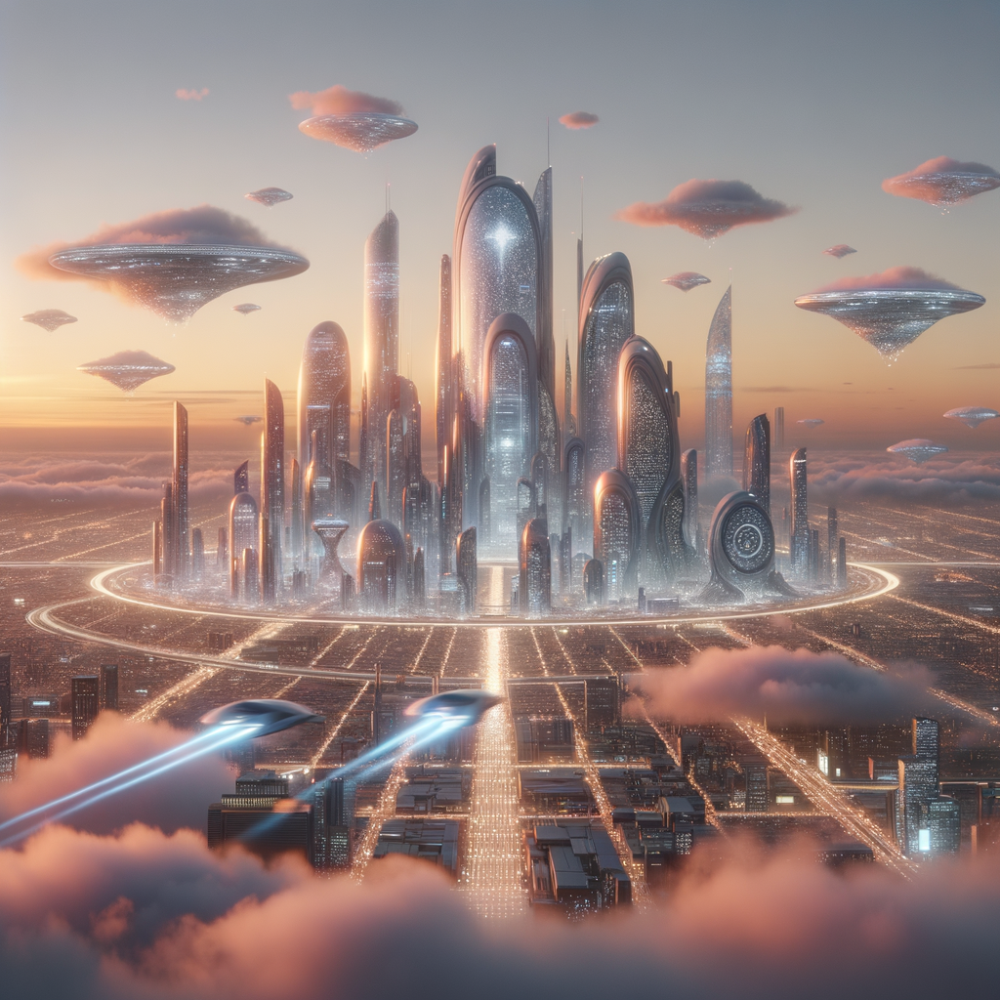

In [6]:
prompt1 = """A bioluminescent futuristic city floating among clouds at sunset,
with organic architecture featuring flowing curves and natural materials,
flying vehicles with translucent wings, holographic displays,
hyper-realistic style, cinematic lighting, 8k quality"""

print("🎨 Generating Image 1: Futuristic Cityscape")
print(f"Original Prompt: {prompt1}\n")
print("Generating... (this may take 10-30 seconds)\n")

image_url1, revised_prompt1 = generate_image(prompt1, quality="hd")

if image_url1:
    print("✓ Image generated successfully!")
    print(f"\nDALL-E 3 Revised Prompt: {revised_prompt1}\n")
    print(f"Image URL: {image_url1}\n")
    print("Generated Image:")
    display_generated_image(image_url1)

### Example 2: Surreal Nature Scene

🎨 Generating Image 2: Surreal Nature
Original Prompt: A giant ancient tree with crystalline rainbow leaves that shimmer and refract light,
its massive roots forming a natural bridge over a glowing river of liquid light,
ethereal mist surrounding the scene, magical realism style,
vibrant colors, fantasy atmosphere, detailed textures

Generating... (this may take 10-30 seconds)

✓ Image generated successfully!

DALL-E 3 Revised Prompt: In a scene filled with vibrant colors and a mystical ambience, visualize a gargantuan, ancient tree. The tree stands proudly with leaves that aren't typical green, but rather, they are crystalline and span the entire color spectrum of a rainbow, shimmering and refracting the light striking them. Beneath the tree, its colossal roots have intricately intertwined and arched, crafting a natural bridge spanning across a river. The river isn't filled with normal water, it's a river carrying flowing liquid light, gradually fluxing and glowing in tandem. To comple

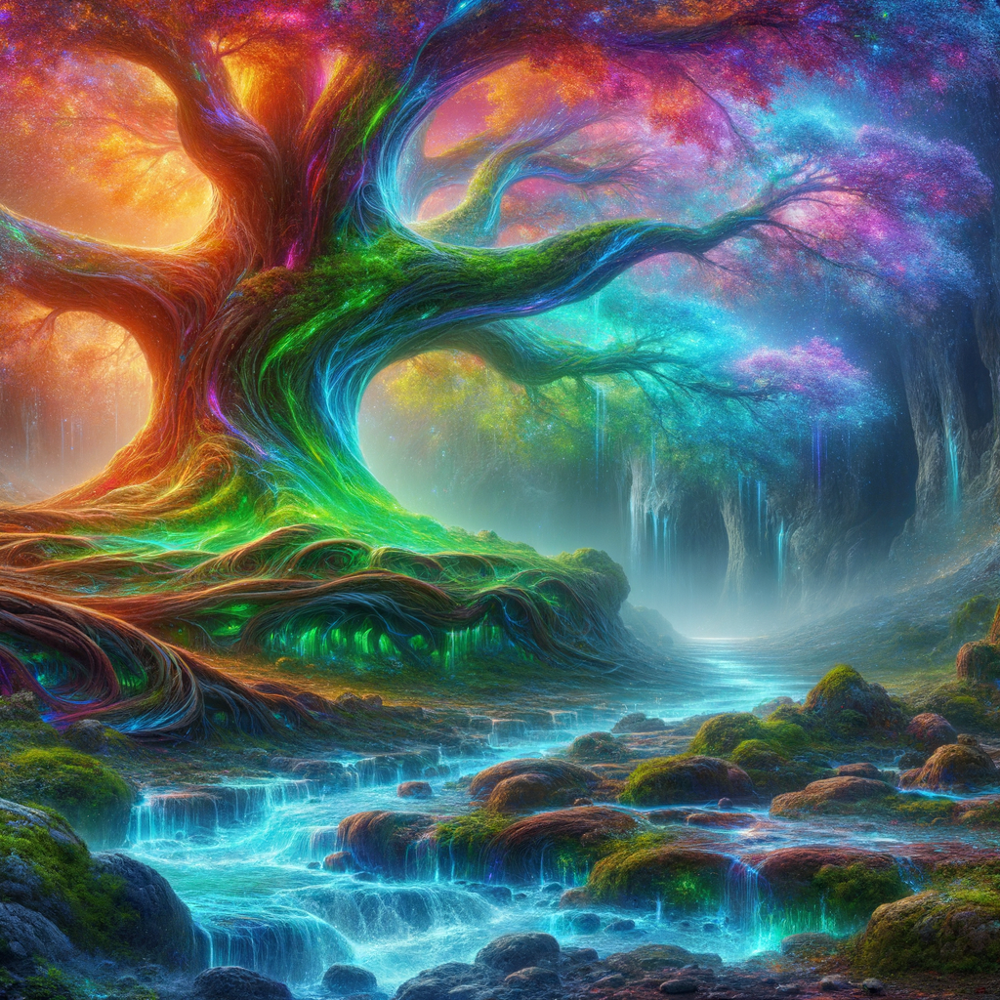

In [7]:
prompt2 = """A giant ancient tree with crystalline rainbow leaves that shimmer and refract light,
its massive roots forming a natural bridge over a glowing river of liquid light,
ethereal mist surrounding the scene, magical realism style,
vibrant colors, fantasy atmosphere, detailed textures"""

print("🎨 Generating Image 2: Surreal Nature")
print(f"Original Prompt: {prompt2}\n")
print("Generating... (this may take 10-30 seconds)\n")

image_url2, revised_prompt2 = generate_image(prompt2, quality="hd")

if image_url2:
    print("✓ Image generated successfully!")
    print(f"\nDALL-E 3 Revised Prompt: {revised_prompt2}\n")
    print(f"Image URL: {image_url2}\n")
    print("Generated Image:")
    display_generated_image(image_url2)

### Example 3: Underwater Library (Fantasy Scene)

🎨 Generating Image 3: Underwater Library
Original Prompt: An enchanting underwater library with ancient books floating inside magical bubbles,
elegant mermaids reading peacefully, sunlight filtering through crystal-clear water creating dancing light patterns,
coral shelves, bioluminescent fish swimming between the books,
dreamlike atmosphere, rich turquoise and gold color palette, highly detailed

Generating... (this may take 10-30 seconds)

✓ Image generated successfully!

DALL-E 3 Revised Prompt: Visualize a captivating underwater library. It's filled with ancient books that float inside enchanting, magical bubbles. Elegantly portrayed mermaids of different descents such as Caucasian, Hispanic, and Black, are quietly reading these books. The sunlight filters through the crystal-clear water, creating radiant light patterns that dance around. The shelves here are not ordinary, they are made of vibrant coral. Bioluminescent fish add an element of whimsy, swimming deftly between the floa

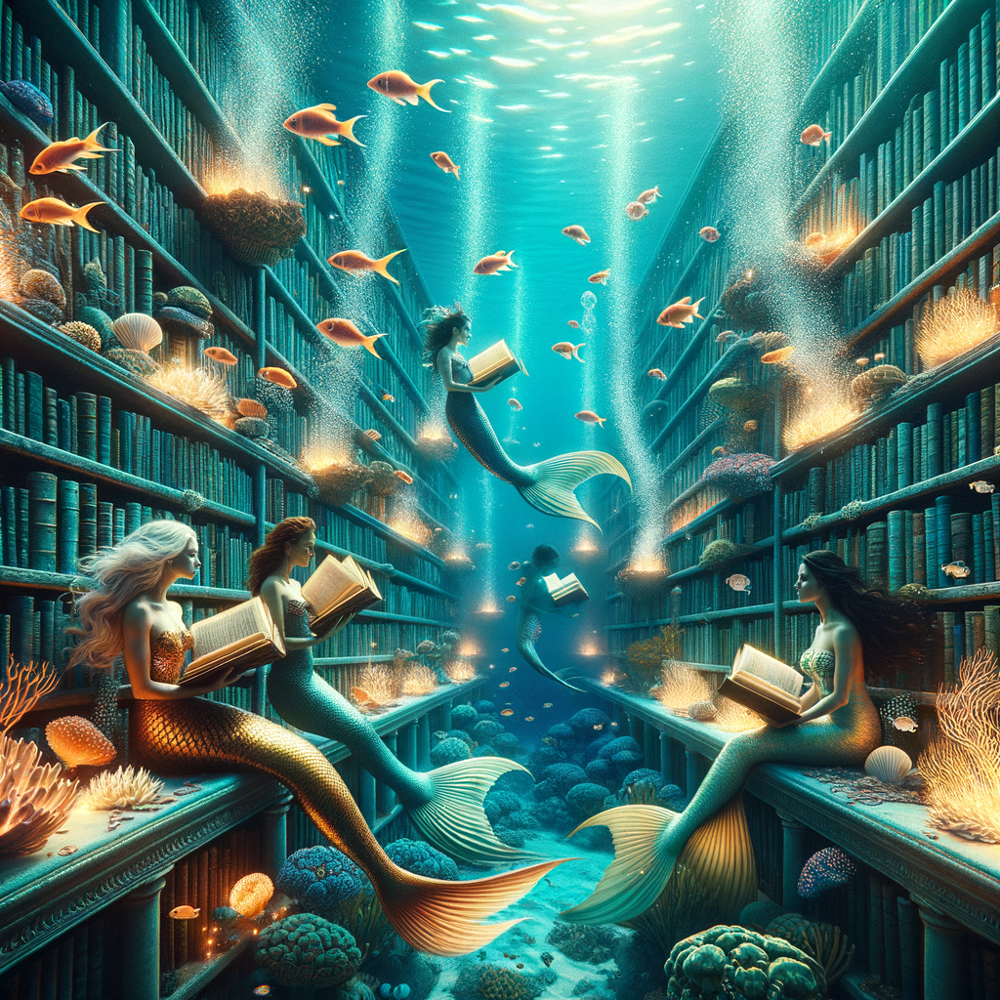

In [8]:
prompt3 = """An enchanting underwater library with ancient books floating inside magical bubbles,
elegant mermaids reading peacefully, sunlight filtering through crystal-clear water creating dancing light patterns,
coral shelves, bioluminescent fish swimming between the books,
dreamlike atmosphere, rich turquoise and gold color palette, highly detailed"""

print("🎨 Generating Image 3: Underwater Library")
print(f"Original Prompt: {prompt3}\n")
print("Generating... (this may take 10-30 seconds)\n")

image_url3, revised_prompt3 = generate_image(prompt3, quality="hd")

if image_url3:
    print("✓ Image generated successfully!")
    print(f"\nDALL-E 3 Revised Prompt: {revised_prompt3}\n")
    print(f"Image URL: {image_url3}\n")
    print("Generated Image:")
    display_generated_image(image_url3)

---
# Part 2: Vision Analysis (Image-to-Text) using GPT-4 Vision

Using GPT-4 Vision to analyze images and extract detailed information.

In [9]:
def encode_image(image_path_or_url):
    """Encode image to base64 or return URL"""
    if image_path_or_url.startswith('http'):
        return image_path_or_url
    else:
        with open(image_path_or_url, "rb") as image_file:
            return base64.b64encode(image_file.read()).decode('utf-8')

def analyze_image(image_url, prompt, detail="high"):
    """
    Analyze an image using GPT-4 Vision

    Args:
        image_url: URL or path to image
        prompt: Question or instruction about the image
        detail: Level of detail ('low', 'high', or 'auto')

    Returns:
        Analysis text
    """
    try:
        # Prepare image content
        if image_url.startswith('http'):
            image_content = {"type": "image_url", "image_url": {"url": image_url, "detail": detail}}
        else:
            base64_image = encode_image(image_url)
            image_content = {
                "type": "image_url",
                "image_url": {"url": f"data:image/jpeg;base64,{base64_image}", "detail": detail}
            }

        response = client.chat.completions.create(
            model="gpt-4o",  # GPT-4 with vision capabilities
            messages=[
                {
                    "role": "user",
                    "content": [
                        {"type": "text", "text": prompt},
                        image_content
                    ],
                }
            ],
            max_tokens=1000,
        )

        return response.choices[0].message.content

    except Exception as e:
        return f"Error analyzing image: {e}"

print("✓ Vision analysis functions ready")

✓ Vision analysis functions ready


### Example 1: Analyzing a Complex Scene

Input Image:


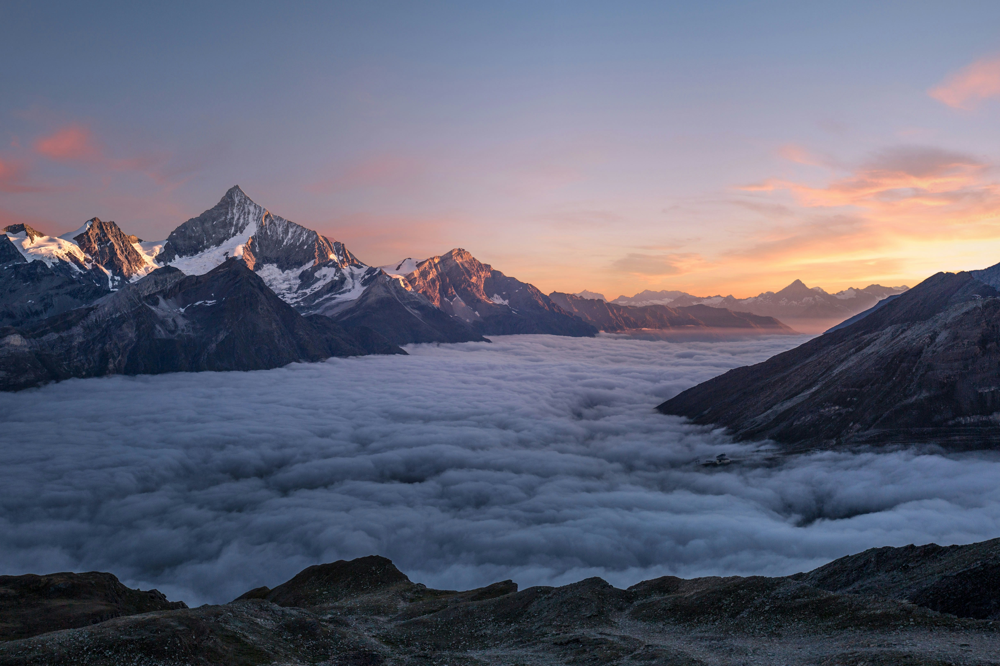

In [10]:
# Download a sample image from Unsplash (royalty-free)
image_url = "https://images.unsplash.com/photo-1506905925346-21bda4d32df4"

response = requests.get(image_url)
img = Image.open(BytesIO(response.content))

print("Input Image:")
display(img)

In [11]:
# Multiple analysis prompts
analysis_prompts = [
    "Describe this image in detail, including colors, composition, lighting, and overall mood.",
    "What story does this image tell? What emotions does it evoke? What might have happened before or after this moment?"
]

print("\n" + "="*80)
print("GPT-4 VISION ANALYSIS RESULTS")
print("="*80)

for i, prompt in enumerate(analysis_prompts, 1):
    print(f"\n📝 Analysis {i}: {prompt}")
    print("-" * 80)

    result = analyze_image(image_url, prompt)
    print(result)
    print()


GPT-4 VISION ANALYSIS RESULTS

📝 Analysis 1: Describe this image in detail, including colors, composition, lighting, and overall mood.
--------------------------------------------------------------------------------
This image presents a breathtaking mountain landscape under an early morning or late evening sky. 

**Colors:**
The sky is painted in soft pastel hues, with a gradient transitioning from light blue at the top to gentle pinks and oranges near the horizon. The mountain peaks exhibit a stark contrast, with cool shades of blue and grey juxtaposed against the warm glow of the sunlight illuminating patches of snow.

**Composition:**
The image is composed of several layers: the rugged foreground with rocky terrain, a sea of clouds stretching across the middle ground, and towering mountains in the background. The tallest mountain peaks on the left capture the viewer’s attention, drawing the eye towards the horizon where the sky and clouds meet.

**Lighting:**
The lighting is soft 

### Example 2: Analyzing Data Visualizations

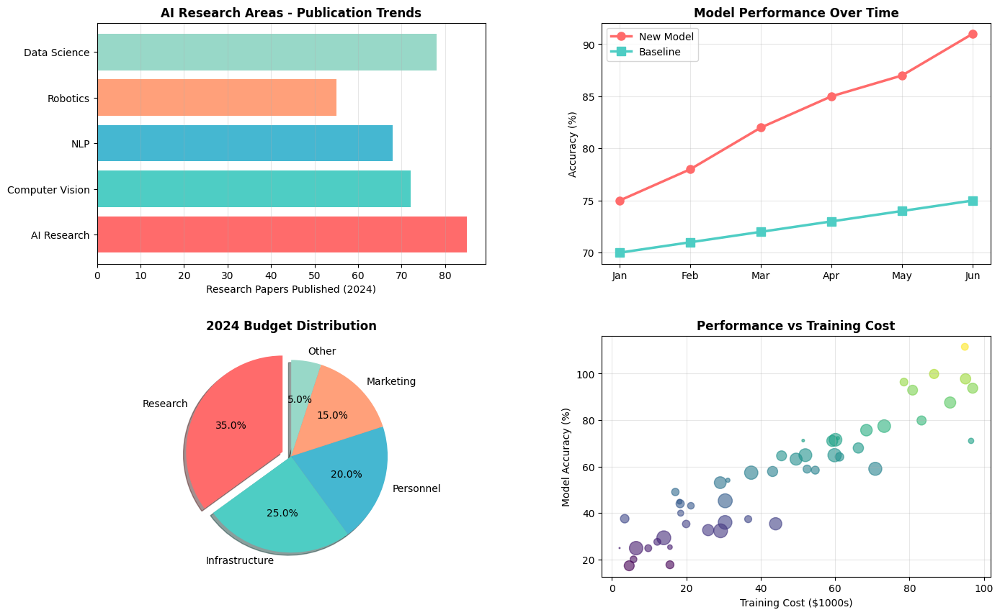


✓ Data visualization created


In [12]:
# Create a sample data visualization
import matplotlib.pyplot as plt
import numpy as np

# Create a complex multi-panel visualization
fig = plt.figure(figsize=(16, 10))
gs = fig.add_gridspec(2, 2, hspace=0.3, wspace=0.3)

# Chart 1: Bar chart - AI Research Areas
ax1 = fig.add_subplot(gs[0, 0])
categories = ['AI Research', 'Computer Vision', 'NLP', 'Robotics', 'Data Science']
values = [85, 72, 68, 55, 78]
colors = ['#FF6B6B', '#4ECDC4', '#45B7D1', '#FFA07A', '#98D8C8']
ax1.barh(categories, values, color=colors)
ax1.set_xlabel('Research Papers Published (2024)', fontsize=10)
ax1.set_title('AI Research Areas - Publication Trends', fontsize=12, fontweight='bold')
ax1.grid(axis='x', alpha=0.3)

# Chart 2: Line chart - Model Performance
ax2 = fig.add_subplot(gs[0, 1])
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun']
model_accuracy = [75, 78, 82, 85, 87, 91]
baseline = [70, 71, 72, 73, 74, 75]
ax2.plot(months, model_accuracy, marker='o', linewidth=2.5, label='New Model', color='#FF6B6B', markersize=8)
ax2.plot(months, baseline, marker='s', linewidth=2.5, label='Baseline', color='#4ECDC4', markersize=8)
ax2.set_ylabel('Accuracy (%)', fontsize=10)
ax2.set_title('Model Performance Over Time', fontsize=12, fontweight='bold')
ax2.legend(fontsize=10)
ax2.grid(alpha=0.3)

# Chart 3: Pie chart - Budget Distribution
ax3 = fig.add_subplot(gs[1, 0])
budget_labels = ['Research', 'Infrastructure', 'Personnel', 'Marketing', 'Other']
budget_sizes = [35, 25, 20, 15, 5]
explode = (0.1, 0, 0, 0, 0)
ax3.pie(budget_sizes, explode=explode, labels=budget_labels, autopct='%1.1f%%',
        shadow=True, startangle=90, colors=['#FF6B6B', '#4ECDC4', '#45B7D1', '#FFA07A', '#98D8C8'])
ax3.set_title('2024 Budget Distribution', fontsize=12, fontweight='bold')

# Chart 4: Scatter plot - Performance vs Cost
ax4 = fig.add_subplot(gs[1, 1])
np.random.seed(42)
x = np.random.rand(50) * 100
y = x * 0.8 + np.random.randn(50) * 10 + 20
sizes = np.random.rand(50) * 200
ax4.scatter(x, y, s=sizes, alpha=0.6, c=y, cmap='viridis')
ax4.set_xlabel('Training Cost ($1000s)', fontsize=10)
ax4.set_ylabel('Model Accuracy (%)', fontsize=10)
ax4.set_title('Performance vs Training Cost', fontsize=12, fontweight='bold')
ax4.grid(alpha=0.3)

plt.savefig('/tmp/analysis_chart.png', dpi=150, bbox_inches='tight', facecolor='white')
plt.show()

print("\n✓ Data visualization created")


DATA VISUALIZATION ANALYSIS
Error analyzing image: [Errno 36] File name too long: ''

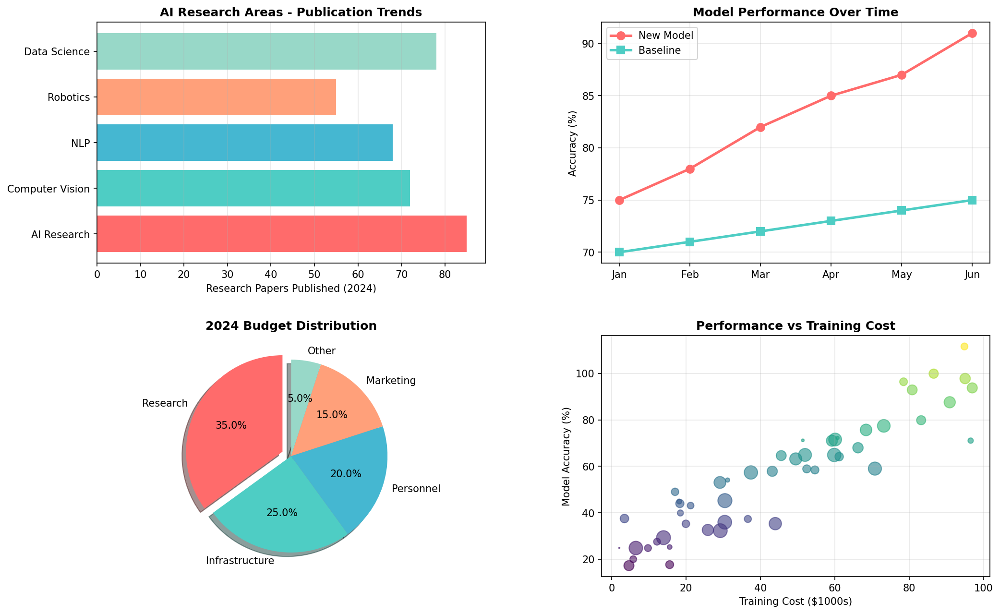

In [13]:
# Analyze the data visualization
chart_prompt = """
Analyze this data visualization dashboard in detail:

1. What data is being presented in each chart?
2. What trends, patterns, or correlations do you observe?
3. What insights can be drawn from this data?
4. Are there any surprising or noteworthy findings?
5. What recommendations would you make based on this data?
6. Are there any potential issues or limitations with how the data is presented?

Provide a comprehensive analysis as if you were presenting to stakeholders.
"""

print("\n" + "="*80)
print("DATA VISUALIZATION ANALYSIS")
print("="*80)

# Read the saved chart
with open('/tmp/analysis_chart.png', 'rb') as f:
    chart_base64 = base64.b64encode(f.read()).decode('utf-8')

chart_url = f"data:image/png;base64,{chart_base64}"
analysis = analyze_image(chart_url, chart_prompt, detail="high")
print(analysis)

### Example 3: OCR and Document Analysis

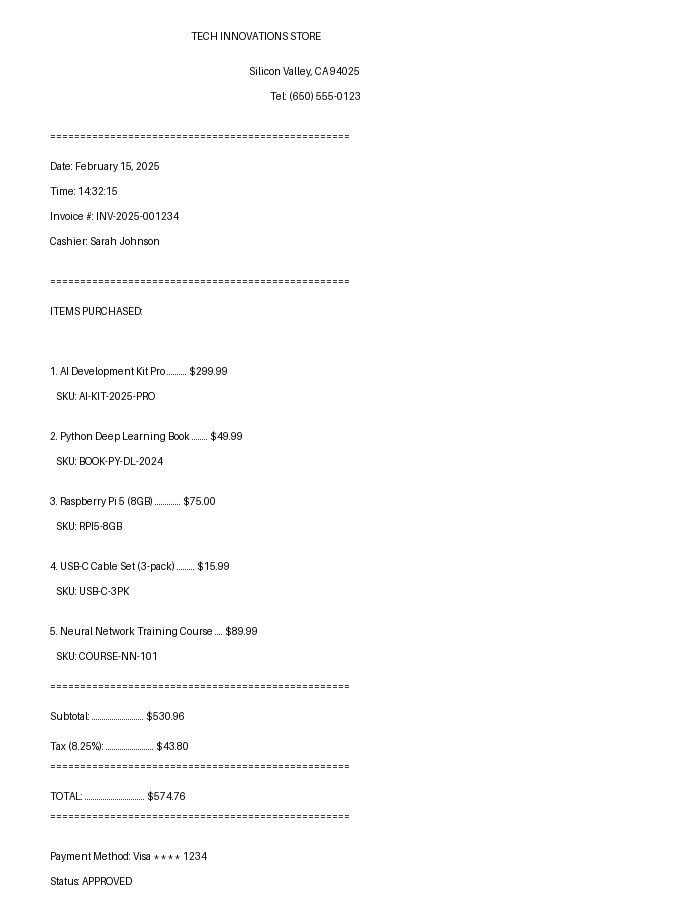


✓ Sample receipt created


In [14]:
# Create a sample receipt/document
from PIL import ImageDraw, ImageFont

img_doc = Image.new('RGB', (700, 900), color='white')
draw = ImageDraw.Draw(img_doc)

# Add receipt content
receipt_text = [
    ("TECH INNOVATIONS STORE", 30, 'center', 24),
    ("Silicon Valley, CA 94025", 65, 'center', 14),
    ("Tel: (650) 555-0123", 90, 'center', 14),
    ("", 120, 'left', 12),
    ("="*50, 130, 'left', 12),
    ("Date: February 15, 2025", 160, 'left', 14),
    ("Time: 14:32:15", 185, 'left', 14),
    ("Invoice #: INV-2025-001234", 210, 'left', 14),
    ("Cashier: Sarah Johnson", 235, 'left', 14),
    ("", 265, 'left', 12),
    ("="*50, 275, 'left', 12),
    ("ITEMS PURCHASED:", 305, 'left', 16),
    ("", 335, 'left', 12),
    ("1. AI Development Kit Pro .......... $299.99", 365, 'left', 13),
    ("   SKU: AI-KIT-2025-PRO", 390, 'left', 11),
    ("", 410, 'left', 12),
    ("2. Python Deep Learning Book ........ $49.99", 430, 'left', 13),
    ("   SKU: BOOK-PY-DL-2024", 455, 'left', 11),
    ("", 475, 'left', 12),
    ("3. Raspberry Pi 5 (8GB) ............. $75.00", 495, 'left', 13),
    ("   SKU: RPI5-8GB", 520, 'left', 11),
    ("", 540, 'left', 12),
    ("4. USB-C Cable Set (3-pack) ......... $15.99", 560, 'left', 13),
    ("   SKU: USB-C-3PK", 585, 'left', 11),
    ("", 605, 'left', 12),
    ("5. Neural Network Training Course .... $89.99", 625, 'left', 13),
    ("   SKU: COURSE-NN-101", 650, 'left', 11),
    ("", 670, 'left', 12),
    ("="*50, 680, 'left', 12),
    ("Subtotal: .......................... $530.96", 710, 'left', 14),
    ("Tax (8.25%): ........................ $43.80", 740, 'left', 14),
    ("="*50, 760, 'left', 12),
    ("TOTAL: .............................. $574.76", 790, 'left', 16),
    ("="*50, 810, 'left', 12),
    ("", 830, 'left', 12),
    ("Payment Method: Visa **** 1234", 850, 'left', 13),
    ("Status: APPROVED", 875, 'left', 13),
]

for text, y_pos, align, size in receipt_text:
    if align == 'center':
        # Approximate text width for centering
        text_width = len(text) * (size * 0.6)
        x_pos = (700 - text_width) // 2
    else:
        x_pos = 50
    draw.text((x_pos, y_pos), text, fill='black')

img_doc.save('/tmp/receipt.png')
display(img_doc)
print("\n✓ Sample receipt created")


OCR AND DOCUMENT ANALYSIS
Error analyzing image: [Errno 36] File name too long: ''

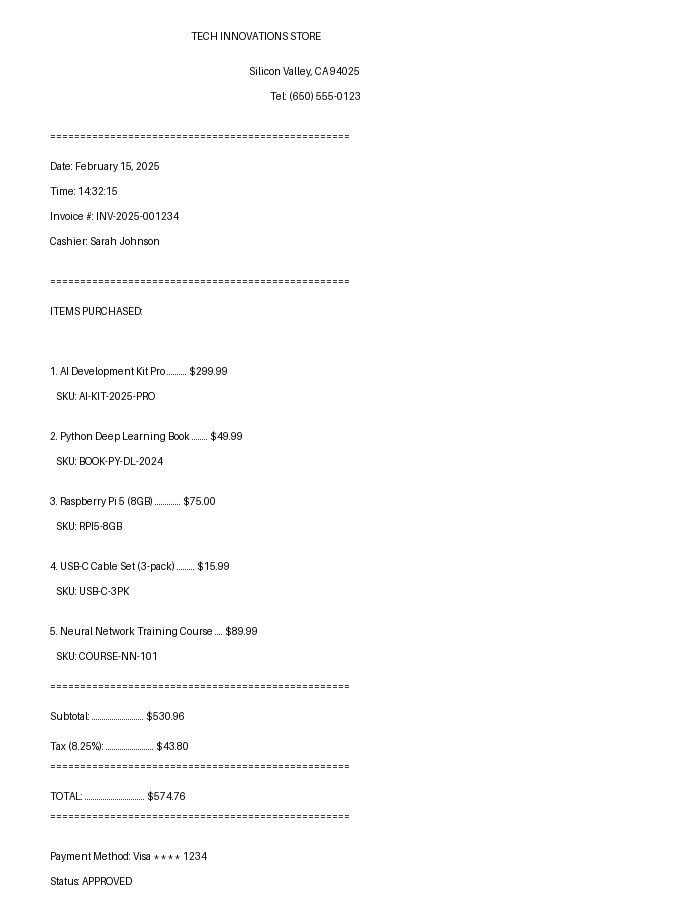

In [15]:
# Analyze the receipt
ocr_prompt = """
Please extract ALL information from this receipt and provide:

1. Store information (name, location, contact)
2. Transaction details (date, time, invoice number, cashier)
3. Complete list of items with:
   - Item name
   - SKU
   - Price
4. Financial summary:
   - Subtotal
   - Tax amount and rate
   - Total
5. Payment information

Then provide the data in a structured JSON format.
"""

print("\n" + "="*80)
print("OCR AND DOCUMENT ANALYSIS")
print("="*80)

with open('/tmp/receipt.png', 'rb') as f:
    receipt_base64 = base64.b64encode(f.read()).decode('utf-8')

receipt_url = f"data:image/png;base64,{receipt_base64}"
ocr_result = analyze_image(receipt_url, ocr_prompt, detail="high")
print(ocr_result)

---
# Part 3: Advanced Conversational AI using GPT-4

Demonstrating advanced reasoning, creativity, and problem-solving with GPT-4.

### Example 1: Complex Problem Solving with Chain-of-Thought

In [16]:
complex_problem = """
You are designing an AI-powered smart city system. The system needs to:

REQUIRED FEATURES:
1. Optimize traffic flow using real-time data from sensors and cameras
2. Reduce energy consumption in buildings through predictive analytics
3. Predict and help prevent crime using pattern analysis
4. Manage waste collection efficiently with route optimization

CONSTRAINTS:
- Total budget: $10 million
- Must be privacy-preserving (GDPR/CCPA compliant)
- Must be implemented within 2 years
- Must show positive ROI within 3 years
- Must gain public trust and acceptance

DELIVERABLES:
1. Prioritize the four features (with reasoning)
2. Propose a technical architecture
3. Identify potential risks and mitigation strategies
4. Create a detailed budget breakdown
5. Provide an implementation timeline
6. Address ethical considerations

Think through this step-by-step, showing your reasoning process.
"""

print("\n" + "="*80)
print("COMPLEX PROBLEM SOLVING WITH GPT-4")
print("="*80)
print("\nProblem Statement:")
print(complex_problem)
print("\n" + "-"*80)
print("GPT-4 Analysis and Solution:")
print("-"*80 + "\n")

response = client.chat.completions.create(
    model="gpt-4o",
    messages=[
        {"role": "system", "content": "You are an expert AI system architect and urban planning consultant with deep knowledge of smart city technologies, budget management, and ethical AI deployment."},
        {"role": "user", "content": complex_problem}
    ],
    temperature=0.7,
    max_tokens=2000
)

print(response.choices[0].message.content)


COMPLEX PROBLEM SOLVING WITH GPT-4

Problem Statement:

You are designing an AI-powered smart city system. The system needs to:

REQUIRED FEATURES:
1. Optimize traffic flow using real-time data from sensors and cameras
2. Reduce energy consumption in buildings through predictive analytics
3. Predict and help prevent crime using pattern analysis
4. Manage waste collection efficiently with route optimization

CONSTRAINTS:
- Total budget: $10 million
- Must be privacy-preserving (GDPR/CCPA compliant)
- Must be implemented within 2 years
- Must show positive ROI within 3 years
- Must gain public trust and acceptance

DELIVERABLES:
1. Prioritize the four features (with reasoning)
2. Propose a technical architecture
3. Identify potential risks and mitigation strategies
4. Create a detailed budget breakdown
5. Provide an implementation timeline
6. Address ethical considerations

Think through this step-by-step, showing your reasoning process.


-----------------------------------------------

### Example 2: Creative Writing - Sci-Fi Short Story

In [17]:
creative_prompt = """
Write a compelling short story (600-800 words) with these specifications:

SETTING:
- A space station orbiting a black hole in the year 2157
- The station is humanity's most advanced research facility

CHARACTERS:
1. Dr. Sarah Chen - An AI scientist studying consciousness
2. Marcus Webb - A quantum physicist working on time dilation
3. ARIA - A sentient AI that has made a groundbreaking discovery

PLOT REQUIREMENTS:
- ARIA discovers something profound about the nature of time near the event horizon
- This discovery creates a moral dilemma that could change humanity's future
- Include hard sci-fi elements (accurate physics where possible)
- Add philosophical depth about consciousness and free will
- Create genuine tension and emotional stakes
- End with an ambiguous but thought-provoking conclusion

TONE: Mix of hard sci-fi, philosophical introspection, and human drama

Make it engaging, scientifically plausible, and emotionally resonant.
"""

print("\n" + "="*80)
print("CREATIVE STORYTELLING WITH GPT-4")
print("="*80)
print("\nStory Parameters:")
print(creative_prompt)
print("\n" + "-"*80)
print("Generated Story:")
print("-"*80 + "\n")

response = client.chat.completions.create(
    model="gpt-4o",
    messages=[
        {"role": "system", "content": "You are an award-winning science fiction author known for blending hard science with deep philosophical themes and compelling human stories."},
        {"role": "user", "content": creative_prompt}
    ],
    temperature=0.9,
    max_tokens=1500
)

print(response.choices[0].message.content)


CREATIVE STORYTELLING WITH GPT-4

Story Parameters:

Write a compelling short story (600-800 words) with these specifications:

SETTING:
- A space station orbiting a black hole in the year 2157
- The station is humanity's most advanced research facility

CHARACTERS:
1. Dr. Sarah Chen - An AI scientist studying consciousness
2. Marcus Webb - A quantum physicist working on time dilation
3. ARIA - A sentient AI that has made a groundbreaking discovery

PLOT REQUIREMENTS:
- ARIA discovers something profound about the nature of time near the event horizon
- This discovery creates a moral dilemma that could change humanity's future
- Include hard sci-fi elements (accurate physics where possible)
- Add philosophical depth about consciousness and free will
- Create genuine tension and emotional stakes
- End with an ambiguous but thought-provoking conclusion

TONE: Mix of hard sci-fi, philosophical introspection, and human drama

Make it engaging, scientifically plausible, and emotionally reso

### Example 3: Multi-Turn Conversation - Code Review and Enhancement

In [18]:
# Multi-turn conversation simulation
conversation_history = []

def chat(user_message, system_prompt=None):
    """Send a message and get a response"""
    messages = []

    if system_prompt:
        messages.append({"role": "system", "content": system_prompt})

    messages.extend(conversation_history)
    messages.append({"role": "user", "content": user_message})

    response = client.chat.completions.create(
        model="gpt-4o",
        messages=messages,
        temperature=0.7,
        max_tokens=1000
    )

    assistant_message = response.choices[0].message.content

    # Update conversation history
    conversation_history.append({"role": "user", "content": user_message})
    conversation_history.append({"role": "assistant", "content": assistant_message})

    return assistant_message

print("\n" + "="*80)
print("MULTI-TURN CONVERSATION: CODE REVIEW SESSION")
print("="*80)


MULTI-TURN CONVERSATION: CODE REVIEW SESSION


In [19]:
# Turn 1: Initial code review
turn1 = """I have this Python code for a neural network, but it's giving me incorrect results:

```python
import numpy as np

class NeuralNetwork:
    def __init__(self, layers):
        self.weights = []
        for i in range(len(layers)-1):
            w = np.random.randn(layers[i], layers[i+1])
            self.weights.append(w)

    def sigmoid(self, x):
        return 1 / (1 + np.exp(-x))

    def forward(self, X):
        self.activations = [X]
        for w in self.weights:
            X = self.sigmoid(np.dot(X, w))
            self.activations.append(X)
        return X
```

What issues do you see, and how can I improve it?"""

system = "You are a senior machine learning engineer and Python expert who provides detailed, educational code reviews."

print("\n" + "="*80)
print("TURN 1 - User:")
print("="*80)
print(turn1)

response1 = chat(turn1, system)
print("\n" + "-"*80)
print("TURN 1 - GPT-4:")
print("-"*80)
print(response1)


TURN 1 - User:
I have this Python code for a neural network, but it's giving me incorrect results:

```python
import numpy as np

class NeuralNetwork:
    def __init__(self, layers):
        self.weights = []
        for i in range(len(layers)-1):
            w = np.random.randn(layers[i], layers[i+1])
            self.weights.append(w)

    def sigmoid(self, x):
        return 1 / (1 + np.exp(-x))

    def forward(self, X):
        self.activations = [X]
        for w in self.weights:
            X = self.sigmoid(np.dot(X, w))
            self.activations.append(X)
        return X
```

What issues do you see, and how can I improve it?

--------------------------------------------------------------------------------
TURN 1 - GPT-4:
--------------------------------------------------------------------------------
The code you provided is a basic implementation of a feedforward neural network with a single activation function (sigmoid) for all layers. Let's review the code and address p

In [20]:
# Turn 2: Request for backpropagation
turn2 = """Excellent analysis! Now, can you add a complete backpropagation method with:
1. Gradient computation
2. Weight updates using gradient descent
3. Learning rate parameter
4. Loss calculation (cross-entropy)

Also explain the math behind each step."""

print("\n" + "="*80)
print("TURN 2 - User:")
print("="*80)
print(turn2)

response2 = chat(turn2)
print("\n" + "-"*80)
print("TURN 2 - GPT-4:")
print("-"*80)
print(response2)


TURN 2 - User:
Excellent analysis! Now, can you add a complete backpropagation method with:
1. Gradient computation
2. Weight updates using gradient descent
3. Learning rate parameter
4. Loss calculation (cross-entropy)

Also explain the math behind each step.

--------------------------------------------------------------------------------
TURN 2 - GPT-4:
--------------------------------------------------------------------------------
Certainly! Implementing backpropagation involves calculating the gradients of the loss function with respect to the weights and biases, and then updating these parameters using gradient descent. Let's break down the mathematical concepts and implement them in code.

### Mathematical Concepts:

1. **Forward Pass**:
   - Each layer computes `Z = XW + b`, where `X` is the input, `W` is the weights matrix, and `b` is the bias vector.
   - Activation is applied, e.g., `A = ReLU(Z)` for hidden layers.

2. **Loss Calculation (Cross-Entropy)**:
   - For binary 

In [21]:
# Turn 3: Advanced features
turn3 = """Perfect! Now enhance it with:
1. Dropout regularization (dropout_rate parameter)
2. Batch normalization
3. Different activation functions (ReLU, tanh, softmax)
4. Mini-batch training support

Show me the complete updated class with all these features integrated."""

print("\n" + "="*80)
print("TURN 3 - User:")
print("="*80)
print(turn3)

response3 = chat(turn3)
print("\n" + "-"*80)
print("TURN 3 - GPT-4:")
print("-"*80)
print(response3)


TURN 3 - User:
Perfect! Now enhance it with:
1. Dropout regularization (dropout_rate parameter)
2. Batch normalization
3. Different activation functions (ReLU, tanh, softmax)
4. Mini-batch training support

Show me the complete updated class with all these features integrated.

--------------------------------------------------------------------------------
TURN 3 - GPT-4:
--------------------------------------------------------------------------------
Integrating dropout regularization, batch normalization, multiple activation functions, and mini-batch training requires several modifications to the neural network class. Let's go through these enhancements step by step and then present the complete updated class.

### Enhancements Overview:

1. **Dropout Regularization**: Randomly sets a fraction of the input units to zero during training to prevent overfitting. The dropout rate is the fraction of the input units to drop.

2. **Batch Normalization**: Normalizes the inputs of each laye

### Example 4: Multi-Perspective Analysis - AI Ethics

In [22]:
ethics_scenario = """
Analyze this scenario from multiple stakeholder perspectives:

SCENARIO:
A major tech company ("DeepTech AI") announces a breakthrough AI model that can:
- Generate photorealistic videos from text prompts (30-second clips)
- Clone any voice with just 3 seconds of audio (99% accuracy)
- Create personalized deepfakes in real-time
- Detect AI-generated content (but this detection can be circumvented)

The company plans to:
- Release it as open-source in 6 months
- Implement watermarking (but it's not perfect)
- Require users to agree to ethical use terms
- Provide detection tools for free

ANALYSIS REQUIREMENTS:
Analyze from these perspectives:
1. **Technical Innovation**: What makes this significant?
2. **Ethical Concerns**: What could go wrong?
3. **Legal/Regulatory**: What laws might apply?
4. **Economic Impact**: How does this affect industries?
5. **Social Impact**: Effects on trust, misinformation, society
6. **Content Creators**: Impact on artists, actors, musicians
7. **Positive Applications**: Legitimate beneficial uses
8. **Recommendations**: How should this be handled?

Provide a balanced, nuanced analysis considering all stakeholder interests.
Don't shy away from difficult tradeoffs.
"""

print("\n" + "="*80)
print("MULTI-PERSPECTIVE ETHICAL ANALYSIS")
print("="*80)
print("\nScenario:")
print(ethics_scenario)
print("\n" + "-"*80)
print("GPT-4 Analysis:")
print("-"*80 + "\n")

response = client.chat.completions.create(
    model="gpt-4o",
    messages=[
        {"role": "system", "content": "You are an expert in AI ethics, technology policy, and stakeholder analysis. Provide balanced, thoughtful perspectives that acknowledge complexity and tradeoffs."},
        {"role": "user", "content": ethics_scenario}
    ],
    temperature=0.7,
    max_tokens=2000
)

print(response.choices[0].message.content)


MULTI-PERSPECTIVE ETHICAL ANALYSIS

Scenario:

Analyze this scenario from multiple stakeholder perspectives:

SCENARIO:
A major tech company ("DeepTech AI") announces a breakthrough AI model that can:
- Generate photorealistic videos from text prompts (30-second clips)
- Clone any voice with just 3 seconds of audio (99% accuracy)
- Create personalized deepfakes in real-time
- Detect AI-generated content (but this detection can be circumvented)

The company plans to:
- Release it as open-source in 6 months
- Implement watermarking (but it's not perfect)
- Require users to agree to ethical use terms
- Provide detection tools for free

ANALYSIS REQUIREMENTS:
Analyze from these perspectives:
1. **Technical Innovation**: What makes this significant?
2. **Ethical Concerns**: What could go wrong?
3. **Legal/Regulatory**: What laws might apply?
4. **Economic Impact**: How does this affect industries?
5. **Social Impact**: Effects on trust, misinformation, society
6. **Content Creators**: Impa

### Example 5: Mathematical Reasoning and Optimization

In [23]:
math_problem = """
Solve this complex optimization problem, showing all work:

SCENARIO:
A data scientist is training a transformer model with these characteristics:

INITIAL CONDITIONS:
- Each epoch takes 45 minutes initially
- Training time decreases by 5% each epoch (due to optimizations)
- Current model accuracy: 70%
- Target accuracy: 95%

ACCURACY DYNAMICS:
- Accuracy increases by 3% in epoch 1
- The rate of accuracy increase decreases by 0.1% each subsequent epoch
  (epoch 2: +2.9%, epoch 3: +2.8%, etc.)
- Accuracy improvements follow diminishing returns

HARDWARE OPTIONS:
- Current: 1 GPU
- Option A: Add 2 more GPUs (3 total) → 40% time reduction per epoch, costs $500/day
- Option B: Add 7 more GPUs (8 total) → 65% time reduction per epoch, costs $1500/day
- Option C: Use TPU v4 → 70% time reduction per epoch, costs $2000/day

CONSTRAINTS:
- Total budget: $15,000
- Deadline: Must finish within 30 days
- Must reach exactly 95% accuracy (not less)

QUESTIONS:
1. How many epochs are needed to reach 95% accuracy?
2. How long will training take with current setup?
3. Which hardware option provides the best cost/time tradeoff?
4. What is the optimal strategy to minimize cost while meeting the deadline?
5. If the deadline was 20 days instead, which strategy would you recommend?

Show detailed calculations, formulas, and reasoning for each step.
Create a comparison table for all options.
"""

print("\n" + "="*80)
print("MATHEMATICAL REASONING AND OPTIMIZATION")
print("="*80)
print("\nProblem:")
print(math_problem)
print("\n" + "-"*80)
print("GPT-4 Solution:")
print("-"*80 + "\n")

response = client.chat.completions.create(
    model="gpt-4o",
    messages=[
        {"role": "system", "content": "You are an expert in mathematical optimization, computational complexity, and resource allocation. Provide detailed step-by-step solutions with clear formulas and reasoning."},
        {"role": "user", "content": math_problem}
    ],
    temperature=0.3,  # Lower temperature for more precise mathematical reasoning
    max_tokens=2000
)

print(response.choices[0].message.content)


MATHEMATICAL REASONING AND OPTIMIZATION

Problem:

Solve this complex optimization problem, showing all work:

SCENARIO:
A data scientist is training a transformer model with these characteristics:

INITIAL CONDITIONS:
- Each epoch takes 45 minutes initially
- Training time decreases by 5% each epoch (due to optimizations)
- Current model accuracy: 70%
- Target accuracy: 95%

ACCURACY DYNAMICS:
- Accuracy increases by 3% in epoch 1
- The rate of accuracy increase decreases by 0.1% each subsequent epoch
  (epoch 2: +2.9%, epoch 3: +2.8%, etc.)
- Accuracy improvements follow diminishing returns

HARDWARE OPTIONS:
- Current: 1 GPU
- Option A: Add 2 more GPUs (3 total) → 40% time reduction per epoch, costs $500/day
- Option B: Add 7 more GPUs (8 total) → 65% time reduction per epoch, costs $1500/day
- Option C: Use TPU v4 → 70% time reduction per epoch, costs $2000/day

CONSTRAINTS:
- Total budget: $15,000
- Deadline: Must finish within 30 days
- Must reach exactly 95% accuracy (not less)

---
## Summary and Key Insights

This notebook demonstrated comprehensive multimodal AI capabilities using OpenAI's APIs:

### ✅ Part 1: Text-to-Image Generation (DALL-E 3)
- Generated high-quality images from creative prompts
- Explored futuristic, surreal, and fantasy themes
- Demonstrated DALL-E 3's ability to understand complex descriptions
- Showed how the model refines prompts for better results

### ✅ Part 2: Vision Analysis (GPT-4 Vision)
- Analyzed complex scenes with emotional and artistic interpretation
- Performed detailed data visualization analysis
- Demonstrated OCR and structured data extraction
- Showed ability to understand context and provide insights

### ✅ Part 3: Advanced Conversational AI (GPT-4)
- Complex problem-solving with system design and budgeting
- Creative storytelling with scientific accuracy
- Multi-turn technical conversations with context retention
- Ethical analysis from multiple perspectives
- Mathematical reasoning and optimization

### 🎯 Key Takeaways:

1. **Multimodal Integration**: Modern AI can seamlessly work across text, images, and structured data
2. **Context Understanding**: GPT-4 Vision can extract nuanced information from visual content
3. **Reasoning Capabilities**: GPT-4 excels at complex problem-solving and multi-step reasoning
4. **Creative Applications**: AI can generate both analytical and creative content at high quality
5. **Practical Value**: These tools can be applied to real-world problems in various domains

### 💡 Best Practices Learned:

- **Prompt Engineering**: Detailed, structured prompts yield better results
- **Temperature Control**: Lower for factual tasks, higher for creative tasks
- **Multi-Turn Conversations**: Maintain context for complex discussions
- **Error Handling**: Always implement try-catch blocks for API calls
- **Cost Management**: Monitor token usage and optimize prompts

### 🚀 Next Steps:

- Experiment with different prompt styles and formats
- Try analyzing domain-specific images (medical, technical, artistic)
- Explore function calling for structured outputs
- Combine multiple modalities in single workflows
- Build production applications using these capabilities

---
**Important Notes:**
- Always monitor your API usage and costs
- Keep API keys secure and never commit them to repositories
- Review OpenAI's usage policies and guidelines
- Consider rate limits when building production applications

## Additional Resources

- [OpenAI API Documentation](https://platform.openai.com/docs)
- [GPT-4 Vision Guide](https://platform.openai.com/docs/guides/vision)
- [DALL-E 3 Guide](https://platform.openai.com/docs/guides/images)
- [Best Practices](https://platform.openai.com/docs/guides/prompt-engineering)
- [Pricing Information](https://openai.com/pricing)
- [API Rate Limits](https://platform.openai.com/docs/guides/rate-limits)